We just got finished with our student team project, which you can find [here](https://socsim.readthedocs.io/), and I thought I'd do a little post mortem on it.

It's a neat little project that implements various simulations of self organized criticality on 2D grids. What is self organized criticality, you might ask? Dunno, I can't tell you.

All right, I do know a little. Imagine the ising system I've written about before. In the version without an external magnetic field, it has a single important parameter that we can set - the temperature. If you sweep through the values of temperature, you can find a single point where the behavior of the system changes qualitatively - order wins over disorder at temperatures below roughly 2.72 in reasonable [set everything to 1] units. Near that value - at criticality - you get large scale behavior, huge fluctuations, exponential slowdowns, etc.

Self organized criticality, as I currently understand it, is basically that, except that as you run your simulation, you realize that it displays criticality for a wide range of parameters (here - temperature). To quote [Wikipedia](https://en.wikipedia.org/w/index.php?title=Self-organized_criticality&oldid=929733066) (emphasis mine):

> the complexity observed emerged in a robust manner that did not depend on finely tuned details of the system: variable parameters in the model could be changed widely without affecting the emergence of critical behavior: hence, self-organized criticality.
<!-- TEASER_END -->

Here's an example, a simulation of forest fire (yellow being fire, green being trees, and purple being ash, from which trees can regrow):

In [30]:
import SOC
model = SOC.Forest(L=100, f=0.0001)  # f being probability of lightning strike
model.run(500, wait_for_n_iters=500)
model.animate_states(notebook=True)

Waiting for wait_for_n_iters=500 iterations before collecting data. This should let the system thermalize.


What we did look for from a practical standpoint in our simulations was **power law scaling** of the number of iterations for each **avalanche** in a system, of avalanche size... and we did find that!

Here's another model we implemented, called the Manna model:

In [19]:
manna = SOC.Manna(L=30)
manna.run(500, wait_for_n_iters = 500)
manna.animate_states(notebook=True)

Waiting for wait_for_n_iters=500 iterations before collecting data. This should let the system thermalize.


This deserves a bit of a longer runtime:

In [23]:
manna_long = SOC.Manna(L=30, save_every = 100)
manna_long.run(50000, wait_for_n_iters = 20000)

Waiting for wait_for_n_iters=20000 iterations before collecting data. This should let the system thermalize.


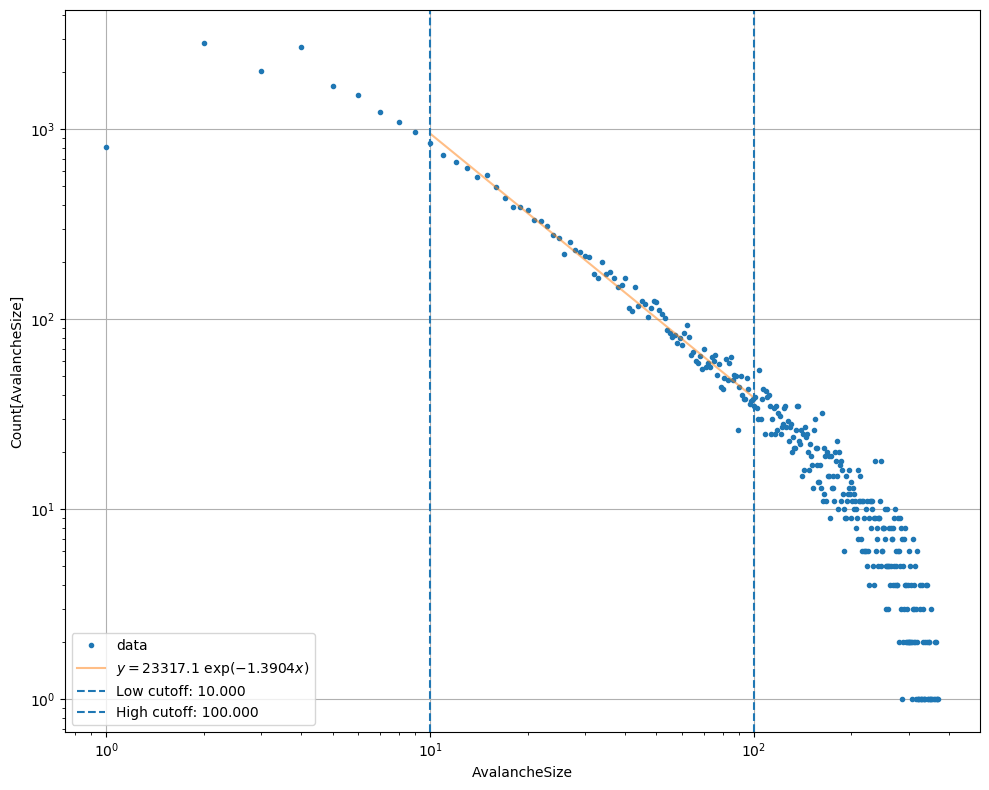

y = 23317.107 exp(-1.3904 x)


{'exponent': -1.3903903386497791, 'intercept': 4.367674673827714}

In [26]:
manna_long.get_exponent(low = 10, high=100)

You can find the project [on GitHub here](https://github.com/SocSIM/SocSIM/).

Apparently, SOC has applications basically everywhere, but I haven't dug into those yet. There's are two articles on my to-read list that relate SOC to [ELMs in fusion reactors](https://journals.aps.org/pre/abstract/10.1103/PhysRevE.101.013207) and [turbulent transport](https://iopscience.iop.org/article/10.1088/0741-3335/57/12/123002). I might do writeups on those in a later post.